## IPLazy RPM

In [1]:
from IPEnvironmentShapeRobot import CollisionCheckerShapeRobot
from IPEnvironmentShapeRobot import ShapeRobot, ShapeRobotWithOrientation
from shapely.geometry import Point, Polygon, LineString
from shapely.affinity import scale, translate
import matplotlib.pyplot as plt

import numpy as np



# Definition of a testing environment
obs1 = LineString([(5,18),(5,8),(20,8),(20,18)]).buffer(1.0)
obs2 = LineString([(15,15), (15,25), (30,25), (30,10)]).buffer(1.0)

# obs2 = scale(obs1, yfact=-1, origin='center')
# obs2 = translate(obs2, xoff=10, yoff=7)
trapField = dict()
trapField["obs1"] = obs1
trapField["obs2"] = obs2

# define robot geometry
robot_shape = Polygon([
    (-0.5, -0.5),  # unten links
    (3, -0.5),     # unten rechts
    (3, 0.0),      # Innenknick rechts
    (0.5, 0.0),    # Innenknick unten horizontal
    (0.5, 1.0),    # oben links vom L-Schenkel
    (-0.5, 1.0)    # oben links außen
])
shape_robot = ShapeRobotWithOrientation(robot_shape, limits=[[0.0, 22.0,], [0.0, 22.0], [-np.pi, np.pi]])

environment = CollisionCheckerShapeRobot(trapField, shape_robot)

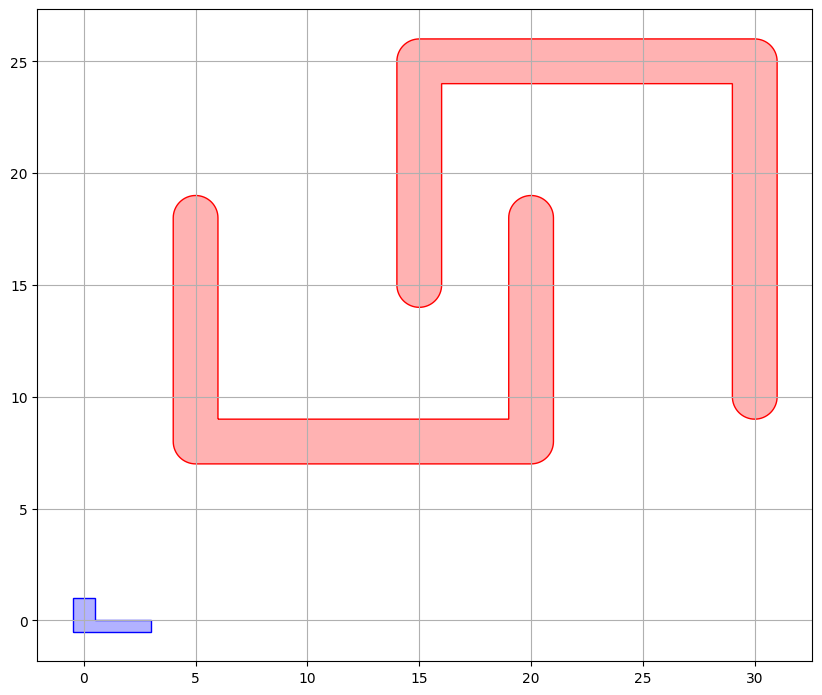

In [2]:
# define robot geometry

fig_local = plt.figure(figsize=(10,10))
ax = fig_local.add_subplot(1,1,1)
environment.drawObstacles(ax)

In [3]:
from IPLazyPRM import LazyPRM

lazyPRM = LazyPRM(environment)
lazyConfig = dict()
lazyConfig["initialRoadmapSize"] = 15 # number of nodes of first roadmap
lazyConfig["updateRoadmapSize"]  = 5 # number of nodes to add if there is no connection from start to end
lazyConfig["kNearest"] = 5 # number of nodes to connect to during setup
lazyConfig["maxIterations"] = 40 # number of nodes to connect to during setup


start = [[25,5,0]]
goal  = [[15,12,0]]

solution = lazyPRM.planPath(start, goal, lazyConfig)
if len(solution) == 0:
    print("No solution found")

solution

['start', 26, 11, 7, 22, 39, 47, 17, 1, 4, 3, 9, 31, 41, 81, 'goal']

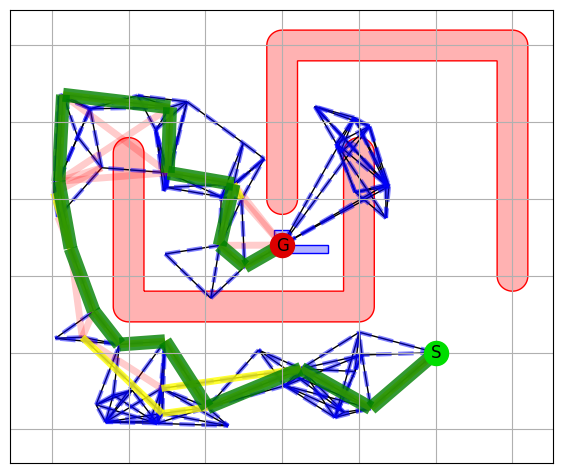

In [4]:
from IPVISLazyPRM import lazyPRMVisualize
fig_local = plt.figure(figsize=(7,7))
ax = fig_local.add_subplot(1,1,1)
lazyPRMVisualize(lazyPRM,solution,ax=ax)

In [5]:
import copy
def interpolate_line(startPos, endPos, step_l):
    steps = []
    line = np.array(endPos) - np.array(startPos)
    line_l = np.linalg.norm(line)
    step = line / line_l * step_l
    n_steps = np.floor(line_l / step_l).astype(np.int32)
    c_step = np.array(startPos, dtype=np.float32)
    for i in range(n_steps):
        steps.append(copy.deepcopy(c_step))
        c_step += step
    if not (c_step == np.array(endPos)).all():
        steps.append(np.array(endPos))
    return steps


In [6]:
from IPVISLazyPRM import visibilityPRMVisualizeWspace
import matplotlib.animation
matplotlib.rcParams['animation.embed_limit'] = 256
from IPython.display import HTML, display

planner=lazyPRM

fig_local = plt.figure(figsize=(7, 7))
ax = fig_local.add_subplot(1, 1, 1)
## get positions for solution
solution_pos = [planner.graph.nodes[node]['pos'] for node in solution]
## interpolate to obtain a smoother movement
i_solution_pos = [solution_pos[0]]
for i in range(1, len(solution_pos)):
    segment_s = solution_pos[i-1]
    segment_e = solution_pos[i]
    i_solution_pos = i_solution_pos + interpolate_line(segment_s, segment_e, 0.5)[1:]
## animate
frames = len(i_solution_pos)

r = environment.robot
workSpaceLimits = environment.robot.getLimits()

def animate(t):
    ## clear taks space figure
    ax.cla()
    ## fix figure size
    ax.set_xlim(workSpaceLimits[0])
    ax.set_ylim(workSpaceLimits[1])
    ## draw obstacles
    #environment.drawObstacles(ax)
    ## update robot position
    pos = i_solution_pos[t]
    r.setTo(pos)
    visibilityPRMVisualizeWspace(lazyPRM,solution,ax=ax)
    

ani = matplotlib.animation.FuncAnimation(fig_local, animate, frames=frames)
html = HTML(ani.to_jshtml())
display(html)
plt.close()



/home/anton/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


## 2D

In [7]:
from IPEnvironmentShapeRobot import ShapeRobot
shape_robot2 = ShapeRobot(robot_shape, limits=[[0.0, 22.0], [0.0, 22.0]])

environment2 = CollisionCheckerShapeRobot(trapField, shape_robot2)

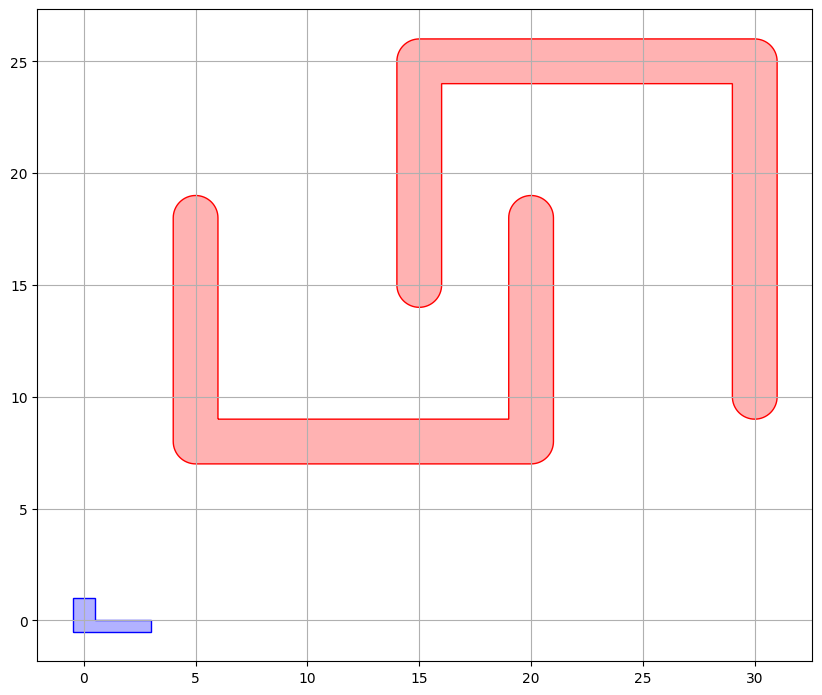

In [8]:
# define robot geometry

fig_local = plt.figure(figsize=(10,10))
ax = fig_local.add_subplot(1,1,1)
environment2.drawObstacles(ax)

In [11]:
lazyPRM2 = LazyPRM(environment2)
lazyConfig2 = dict()
lazyConfig2["initialRoadmapSize"] = 15 # number of nodes of first roadmap
lazyConfig2["updateRoadmapSize"]  = 5 # number of nodes to add if there is no connection from start to end
lazyConfig2["kNearest"] = 5 # number of nodes to connect to during setup
lazyConfig2["maxIterations"] = 40 # number of nodes to connect to during setup

start2 = [[25,5]]
goal2  = [[15,12]]

solution2 = lazyPRM2.planPath(start2, goal2, lazyConfig2)
if len(solution2) == 0:
    print("No solution found")

solution2

['start', 15, 11, 5, 6, 48, 83, 49, 19, 4, 'goal']

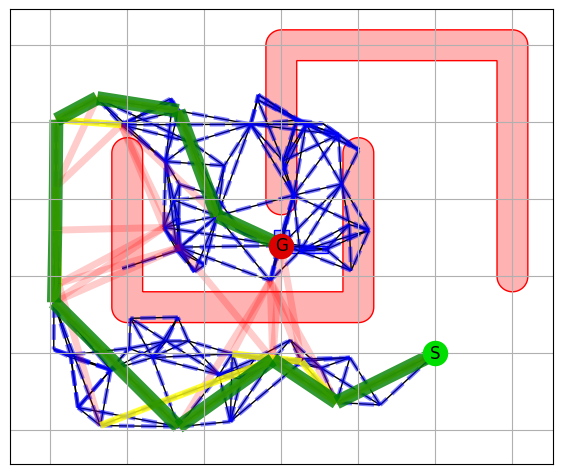

In [12]:
fig_local = plt.figure(figsize=(7,7))
ax = fig_local.add_subplot(1,1,1)
lazyPRMVisualize(lazyPRM2,solution2,ax=ax)

In [13]:
planner=lazyPRM2

fig_local = plt.figure(figsize=(7, 7))
ax = fig_local.add_subplot(1, 1, 1)
## get positions for solution
solution_pos = [planner.graph.nodes[node]['pos'] for node in solution2]
## interpolate to obtain a smoother movement
i_solution_pos = [solution_pos[0]]
for i in range(1, len(solution_pos)):
    segment_s = solution_pos[i-1]
    segment_e = solution_pos[i]
    # choose granularity of interpolation here
    i_solution_pos = i_solution_pos + interpolate_line(segment_s, segment_e, 0.5)[1:]
## animate
frames = len(i_solution_pos)

r = environment2.robot
workSpaceLimits = environment2.robot.getLimits()

def animate(t):
    ## clear taks space figure
    ax.cla()
    ## fix figure size
    ax.set_xlim(workSpaceLimits[0])
    ax.set_ylim(workSpaceLimits[1])
    ## draw obstacles
    #environment.drawObstacles(ax)
    ## update robot position
    pos = i_solution_pos[t]
    r.setTo(pos)
    visibilityPRMVisualizeWspace(lazyPRM2,solution2,ax=ax)
    

ani = matplotlib.animation.FuncAnimation(fig_local, animate, frames=frames)
html = HTML(ani.to_jshtml())
display(html)
plt.close()



/home/anton/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(
